In [1]:
import os
os.chdir(os.path.dirname(os.path.dirname(os.getcwd())))

In [2]:
import pickle
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm

In [41]:
np.arange(24-6, 24)

array([18, 19, 20, 21, 22, 23])

In [42]:
def find_overlap(horizon, step):
    overlap = [i for i in range(step,horizon)]
    return overlap

def generate_lists(step, horizon):
    previous_list = np.arange(step, horizon)
    current_list = np.arange(horizon - step)
    return previous_list, current_list

def generate_lists_same_line(counter, horizon):
    previous_list = np.arange(counter, horizon)
    current_list = np.arange(counter, horizon)
    return previous_list, current_list

def MAC(y_forecast, y_forecast_previous):
    h = len(y_forecast)
    if h != len(y_forecast_previous):
        raise ValueError("Input lists must have the same length")
    mac = 0
    for i in range(h):
        numerator = abs(y_forecast[i] - y_forecast_previous[i])
        mac += numerator
    mac /= (h)
    return mac

In [65]:
phase_num = 3
MAC_steps = {}
MAC_steps_dict = {}
for step_forecast in range(1, 23):
    MAC_steps[step_forecast] = {}
    tog_forecast_temp = pd.read_csv(f'debug_logs/pow_gurobi_phase_{phase_num}_step_leap_{step_forecast}_forecast_step_{step_forecast}.csv', index_col='time_step')
    for b_num in range(5):
        tog_forecast_build = tog_forecast_temp[tog_forecast_temp['building'] == b_num].copy()
        tog_forecast_build.drop(columns=['building'], inplace=True)
        #print(prev_indices, current_indices)
        # impute the row above for missing indexes
        tog_forecast_array = tog_forecast_build.values
        MAC_v = np.zeros(8759)
        for i in range(8759-step_forecast):
            counter = i % step_forecast
            # print(f'row: {i}')
            # print(f'counter: {counter}')
            if counter == 0:
                last_index = i 
                prev_indices, current_indices = generate_lists(step_forecast,24)
                tog_forecast_previous = tog_forecast_build.loc[i][prev_indices]
                tog_forecast_current = tog_forecast_build.loc[i+step_forecast][prev_indices]
            else:
                prev_indices, current_indices = generate_lists_same_line(counter,24)
                tog_forecast_previous = tog_forecast_build.loc[last_index][prev_indices]
                tog_forecast_current = tog_forecast_build.loc[last_index][current_indices]
            #print(prev_indices, current_indices)
            MAC_v[i] = MAC(tog_forecast_current, tog_forecast_previous)
        #print(f'sMAPC{sMAPC_v.mean()}
        print(f'MAC{MAC_v.mean()}')
        MAC_steps[step_forecast][b_num] = MAC_v.mean()
    MAC_steps_dict[step_forecast] = np.mean(list(MAC_steps[step_forecast].values()))

row: 0
counter: 0
row: 1
counter: 0
row: 2
counter: 0
row: 3
counter: 0
row: 4
counter: 0
row: 5
counter: 0
row: 6
counter: 0
row: 7
counter: 0
row: 8
counter: 0
row: 9
counter: 0
row: 10
counter: 0
row: 11
counter: 0
row: 12
counter: 0
row: 13
counter: 0
row: 14
counter: 0
row: 15
counter: 0
row: 16
counter: 0
row: 17
counter: 0
row: 18
counter: 0
row: 19
counter: 0
row: 20
counter: 0
row: 21
counter: 0
row: 22
counter: 0
row: 23
counter: 0
row: 24
counter: 0
row: 25
counter: 0
row: 26
counter: 0
row: 27
counter: 0
row: 28
counter: 0
row: 29
counter: 0
row: 30
counter: 0
row: 31
counter: 0
row: 32
counter: 0
row: 33
counter: 0
row: 34
counter: 0
row: 35
counter: 0
row: 36
counter: 0
row: 37
counter: 0
row: 38
counter: 0
row: 39
counter: 0
row: 40
counter: 0
row: 41
counter: 0
row: 42
counter: 0
row: 43
counter: 0
row: 44
counter: 0
row: 45
counter: 0
row: 46
counter: 0
row: 47
counter: 0
row: 48
counter: 0
row: 49
counter: 0
row: 50
counter: 0
row: 51
counter: 0
row: 52
counter: 0
row

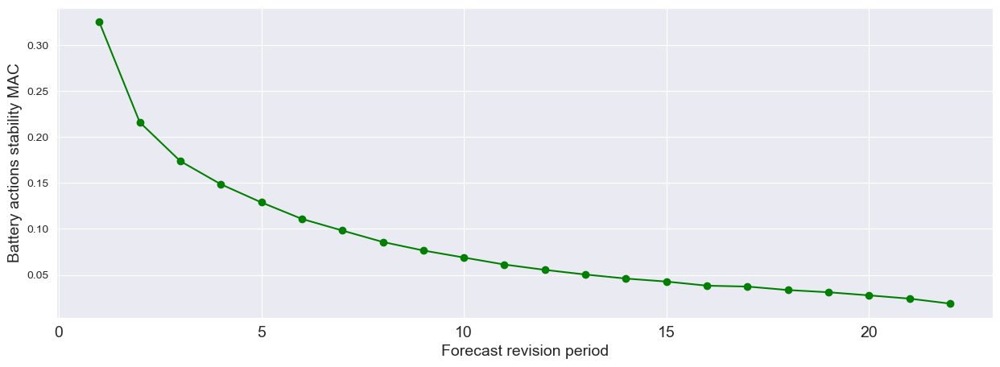

In [66]:
# seaborn darkgrid style style
sns.set_style("darkgrid")
# plot just the MAC
fig, ax = plt.subplots(1, 1, figsize=(15, 5))
ax.plot(list(MAC_steps_dict.keys())[:], list(MAC_steps_dict.values())[:], marker='o', color='green', label='In-sample')
# make x ticks bigger
ax.tick_params(axis='x', labelsize=14)
ax.set_xlabel('Forecast revision period', fontsize=14)
ax.set_ylabel('Battery actions stability MAC', fontsize=14)
#ax.set_title(f'Forecast stability (MAC) vs forecast deployment step (In-sample)', fontsize=16)
plt.show()

In [68]:
phase_num = 1
MAC_steps = {}
MAC_steps_dict = {}
for step_forecast in range(1, 23):
    MAC_steps[step_forecast] = {}
    tog_forecast_temp = pd.read_csv(f'debug_logs/pow_gurobi_phase_{phase_num}_step_leap_{step_forecast}_forecast_step_{step_forecast}.csv', index_col='time_step')
    for b_num in range(5):
        tog_forecast_build = tog_forecast_temp[tog_forecast_temp['building'] == b_num].copy()
        tog_forecast_build.drop(columns=['building'], inplace=True)
        #print(prev_indices, current_indices)
        # impute the row above for missing indexes
        tog_forecast_array = tog_forecast_build.values
        MAC_v = np.zeros(8759)
        for i in range(8759-step_forecast):
            counter = i % step_forecast
            # print(f'row: {i}')
            # print(f'counter: {counter}')
            if counter == 0:
                last_index = i 
                prev_indices, current_indices = generate_lists(step_forecast,24)
                tog_forecast_previous = tog_forecast_build.loc[i][prev_indices]
                tog_forecast_current = tog_forecast_build.loc[i+step_forecast][prev_indices]
            else:
                prev_indices, current_indices = generate_lists_same_line(counter,24)
                tog_forecast_previous = tog_forecast_build.loc[last_index][prev_indices]
                tog_forecast_current = tog_forecast_build.loc[last_index][current_indices]
            #print(prev_indices, current_indices)
            MAC_v[i] = MAC(tog_forecast_current, tog_forecast_previous)
        #print(f'sMAPC{sMAPC_v.mean()}
        print(f'MAC{MAC_v.mean()}')
        MAC_steps[step_forecast][b_num] = MAC_v.mean()
    MAC_steps_dict[step_forecast] = np.mean(list(MAC_steps[step_forecast].values()))

MAC0.4158285199847011
MAC0.3424657292554115
MAC0.3240343541600289
MAC0.3400809453086235
MAC0.3175295793473254
MAC0.3222125013154814
MAC0.2600133893077643
MAC0.24611014359202096
MAC0.2420018000869398
MAC0.24257186323554064
MAC0.27594167243406986
MAC0.22306811243451888
MAC0.2115927788673711
MAC0.1998319797980113
MAC0.20513454702742015
MAC0.23877272004950287
MAC0.1988125005257962
MAC0.1905053317094913
MAC0.16960137781602524
MAC0.17846480431244757
MAC0.20909473566464065
MAC0.17622852596100488
MAC0.17310340692315576
MAC0.14801672807936264
MAC0.15757563091590635
MAC0.18857489017066062
MAC0.15583658587751792
MAC0.1558401418801395
MAC0.12909366065554403
MAC0.1405335835237717
MAC0.1654332593950491
MAC0.13981546209384824
MAC0.1425239316061838
MAC0.11512348819737055
MAC0.1275562667494974
MAC0.1467310965867533
MAC0.12256649719274877
MAC0.12642213997399013
MAC0.10242457896471029
MAC0.11411728897434714
MAC0.13236105121241673
MAC0.11158482105812564
MAC0.1158232532592107
MAC0.09224834526708019
MAC0.10

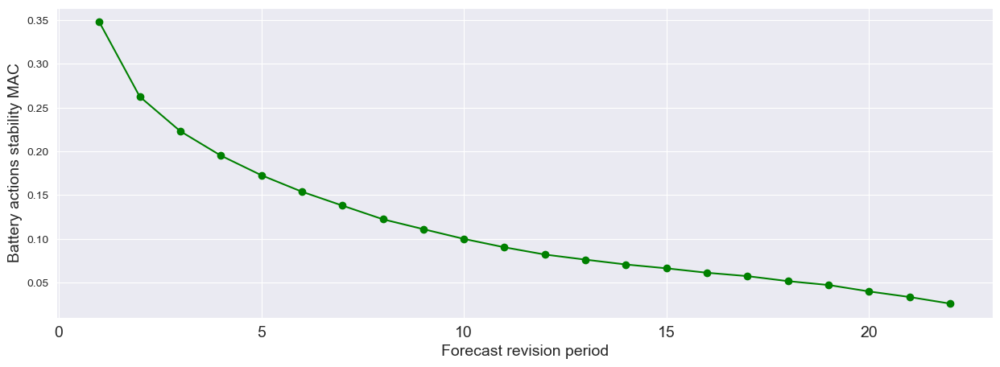

In [69]:
# seaborn darkgrid style style
sns.set_style("darkgrid")
# plot just the MAC
fig, ax = plt.subplots(1, 1, figsize=(15, 5))
ax.plot(list(MAC_steps_dict.keys())[:], list(MAC_steps_dict.values())[:], marker='o', color='green', label='In-sample')
# make x ticks bigger
ax.tick_params(axis='x', labelsize=14)
ax.set_xlabel('Forecast revision period', fontsize=14)
ax.set_ylabel('Battery actions stability MAC', fontsize=14)
#ax.set_title(f'Forecast stability (MAC) vs forecast deployment step (In-sample)', fontsize=16)
plt.show()

In [76]:
phase_num = 3
MAC_steps = {}
MAC_steps_dict = {}
for step_forecast in range(1, 23):
    MAC_steps[step_forecast] = {}
    tog_forecast_temp = pd.read_csv(f'debug_logs/pow_gurobi_phase_{phase_num}_step_leap_1_forecast_step_{step_forecast}.csv', index_col='time_step')
    for b_num in range(5):
        tog_forecast_build = tog_forecast_temp[tog_forecast_temp['building'] == b_num].copy()
        tog_forecast_build.drop(columns=['building'], inplace=True)
        #print(prev_indices, current_indices)
        # impute the row above for missing indexes
        tog_forecast_array = tog_forecast_build.values
        MAC_v = np.zeros(8759)
        for i in range(8759-step_forecast):
            prev_indices, current_indices = generate_lists(1,24)
            tog_forecast_previous = tog_forecast_build.loc[i][prev_indices]
            tog_forecast_current = tog_forecast_build.loc[i+1][prev_indices]
            #print(prev_indices, current_indices)
            MAC_v[i] = MAC(tog_forecast_current, tog_forecast_previous)
        #print(f'sMAPC{sMAPC_v.mean()}
        print(f'MAC{MAC_v.mean()}')
        MAC_steps[step_forecast][b_num] = MAC_v.mean()
    MAC_steps_dict[step_forecast] = np.mean(list(MAC_steps[step_forecast].values()))

MAC0.400973307337183
MAC0.22874658795211494
MAC0.4090657471524196
MAC0.3579503260776763
MAC0.22992757161234392
MAC0.4021725587319279
MAC0.23624992251624524
MAC0.40893539105705573
MAC0.356151757535399
MAC0.23514886295713233
MAC0.4020803098502799
MAC0.23592528034826618
MAC0.40861941607038355
MAC0.35332975008416906
MAC0.2365937594136505
MAC0.4020518195191044
MAC0.2375736821778888
MAC0.40636988473860036
MAC0.35497482883567244
MAC0.2376210451565153
MAC0.40223366754769085
MAC0.23736309313176956
MAC0.40884391377313895
MAC0.3534990231847256
MAC0.2383776325506009
MAC0.40224680370655397
MAC0.2357284828282069
MAC0.40784885556759326
MAC0.3531546790327908
MAC0.23853597155987005
MAC0.40505535626540934
MAC0.23813180955939164
MAC0.4072881583345386
MAC0.3533133803503361
MAC0.2383685777502016
MAC0.4019516948014725
MAC0.2388714956683399
MAC0.40804325598133134
MAC0.35132586729219645
MAC0.239485441150566
MAC0.40222146943070886
MAC0.23848652570001944
MAC0.4052054711595598
MAC0.35240912681492803
MAC0.2396309

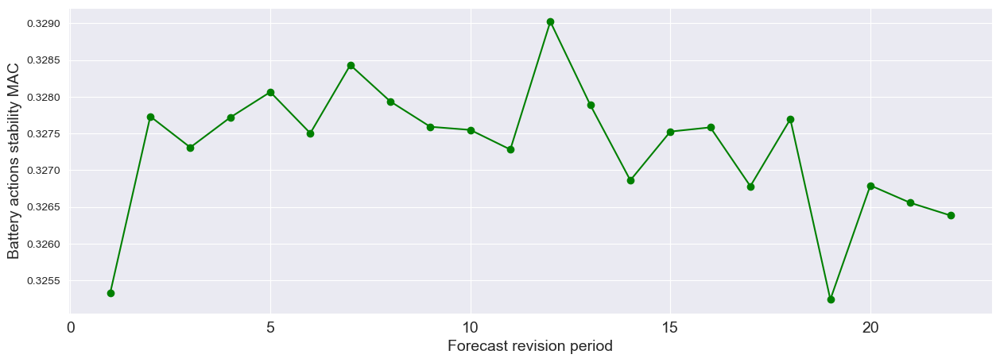

In [77]:
# seaborn darkgrid style style
sns.set_style("darkgrid")
# plot just the MAC
fig, ax = plt.subplots(1, 1, figsize=(15, 5))
ax.plot(list(MAC_steps_dict.keys())[:], list(MAC_steps_dict.values())[:], marker='o', color='green', label='In-sample')
# make x ticks bigger
ax.tick_params(axis='x', labelsize=14)
ax.set_xlabel('Forecast revision period', fontsize=14)
ax.set_ylabel('Battery actions stability MAC', fontsize=14)
#ax.set_title(f'Forecast stability (MAC) vs forecast deployment step (In-sample)', fontsize=16)
plt.show()